<a href="https://colab.research.google.com/github/Dr-Schmoctor/sales-predictions/blob/main/Prediction_of_Product_Sales_Machine_Learning_Processing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Prediction of Product Sales
- Author: Jeffrey Prichard


##Data Dictionary

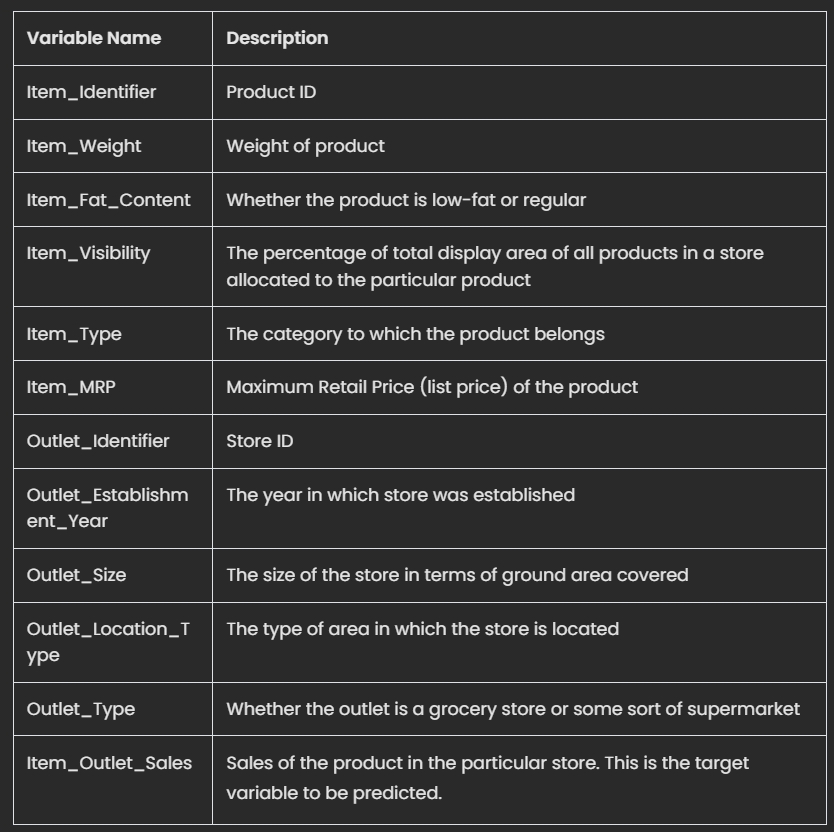

##Imports/Settings

In [7]:
## Pandas
import pandas as pd

## Numpy
import numpy as np

## MatPlotLib
import matplotlib.pyplot as plt

#seaborn
import seaborn as sns

## Preprocessing
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.compose import make_column_selector
from sklearn.preprocessing import StandardScaler, OneHotEncoder, OrdinalEncoder
from sklearn.pipeline import make_pipeline
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer

## Models
from sklearn.dummy import DummyRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression

## Regression Metrics
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

import matplotlib.pyplot as plt
from sklearn.tree import plot_tree

# Set the default transformation output to Pandas
from sklearn import set_config

from IPython.core.display import clear_output

## Set global scikit-learn configuration
from sklearn import set_config

## Warnings
import warnings

In [8]:
## Set filter warnings to ignore
warnings.filterwarnings('ignore')

## Display all columns
pd.set_option('display.max_column', None)

## Display all rows
pd.set_option('display.max_rows', None)

In [9]:
## SK Learn Display
set_config(display='diagram')

## Transformers output as a Pandas Dataframe
set_config(transform_output='pandas')

##Functions

In [10]:
def regression_metrics(y_true, y_pred, label='', verbose=True, output_dict=False):

  """Helper Function
  This custom function accept true targets and predictions with custom label
  Calculate and print  MAE, MSE , RMSE and R2 scores by saving it in a dictionary"""

  # Get metrics
  mae = mean_absolute_error(y_true, y_pred)
  mse = mean_squared_error(y_true, y_pred)
  rmse = mean_squared_error(y_true, y_pred, squared=False)
  r_squared = r2_score(y_true, y_pred)
  if verbose == True:
    # Print Result with Label and Header
    header = "-"*60
    print(header, f"Regression Metrics: {label}", header, sep='\n')
    print(f"- MAE = {mae:,.3f}")
    print(f"- MSE = {mse:,.3f}")
    print(f"- RMSE = {rmse:,.3f}")
    print(f"- R^2 = {r_squared:,.3f}")
  if output_dict == True:
      metrics = {'Label':label, 'MAE':mae,
                 'MSE':mse, 'RMSE':rmse, 'R^2':r_squared}
      return metrics

In [11]:
def evaluate_regression(reg, X_train, y_train, X_test, y_test, verbose=True,
                        output_frame=False, model_name=''):

  """This custom function accepts the model, X_train, y_train, X_test, and y_test
  Obtains the predictions from the model for both training and test data
  Inputs the true and predicted values into the helper function to obtain all the metrics for both the training and test data.
  Prints the results (optional with default as True
  Save the results as a dataframe (optional with default as False)"""

  # Get predictions for training data
  y_train_pred = reg.predict(X_train)

  # Call the helper function to obtain regression metrics for training data
  results_train = regression_metrics(y_train, y_train_pred, verbose = verbose,
                                     output_dict=output_frame,
                                     label= model_name + ' ' + 'Training Data')
  print()
  # Get predictions for test data
  y_test_pred = reg.predict(X_test)
  # Call the helper function to obtain regression metrics for test data
  results_test = regression_metrics(y_test, y_test_pred, verbose = verbose,
                                  output_dict=output_frame,
                                    label=model_name + ' ' + 'Test Data' )

  # Store results in a dataframe if ouput_frame is True
  if output_frame:
    results_df = pd.DataFrame([results_train, results_test])
    # Set the label as the index
    results_df = results_df.set_index('Label')
    # Set index.name to none to get a cleaner looking result
    results_df.index.name=None
    # Return the dataframe
    return results_df.round(3)

In [82]:
# Custom function
def plot_coeffs(coeffs, top_n=None, figsize=(4,5),
                intercept=False, intercept_name="intercept",
                annotate=False, ha='left', va='center', size=12,
                xytext=(4,0), textcoords='offset points'):

    # Drop intercept if intercept=False and
    if (intercept == False) & (intercept_name in coeffs.index):
        coeffs = coeffs.drop(intercept_name)
    if top_n == None:
        ## sort all features and set title
        plot_vals = coeffs.sort_values()
        title = "All Coefficients - Ranked by Magnitude"
    else:
        ## rank the coeffs and select the top_n
        coeff_rank = coeffs.abs().rank().sort_values(ascending=False)
        top_n_features = coeff_rank.head(top_n)

        ## sort features and keep top_n and set title
        plot_vals = coeffs.loc[top_n_features.index].sort_values()
        title = f"Top {top_n} Largest Coefficients"
    ## plotting top N importances
    ax = plot_vals.plot(kind='barh', figsize=figsize)
    ax.set(xlabel='Coefficient',
            ylabel='Feature Names',
            title=title)
    ax.axvline(0, color='k')
    if annotate == True:
        annotate_hbars(ax, ha=ha, va=va, size=size, xytext=xytext, textcoords=textcoords)
    return ax

In [85]:
# Custom function
def annotate_hbars(ax, ha='left', va='center', size=12, xytext=(4,0),
                  textcoords='offset points'):
    for bar in ax.patches:

        ## calculate center of bar
        bar_ax = bar.get_y() + bar.get_height() / 2
        ## get the value to annotate
        val = bar.get_width()
        if val < 0:
            val_pos = 0
        else:
            val_pos = val
        # ha and va stand for the horizontal and vertical alignment
        ax.annotate(f"{val:.3f}", (val_pos,bar_ax), ha=ha, va=va, size=size,
                        xytext=xytext, textcoords=textcoords)

In [98]:
# Custom importances
def get_importances(model, feature_names=None,name='Feature Importance',
                   sort=False, ascending=True):

    ## checking for feature names
    if feature_names == None:
        feature_names = model.feature_names_in_

    ## Saving the feature importances
    importances = pd.Series(model.feature_importances_, index= feature_names,
                           name=name)

    # sort importances
    if sort == True:
        importances = importances.sort_values(ascending=ascending)

    return importances

In [99]:
def plot_importance(importances, top_n=None,  figsize=(8,6)):
    # sorting with asc=false for correct order of bars
    if top_n==None:
        ## sort all features and set title
        plot_vals = importances.sort_values()
        title = "All Features - Ranked by Importance"
    else:
        ## sort features and keep top_n and set title
        plot_vals = importances.sort_values().tail(top_n)
        title = f"Top {top_n} Most Important Features"
    ## plotting top N importances
    ax = plot_vals.plot(kind='barh', figsize=figsize)
    ax.set(xlabel='Importance',
            ylabel='Feature Names',
            title=title)
    ## return ax in case want to continue to update/modify figure
    return ax

#Load/Inspect Data

##Loading Data

In [12]:
#File location
file = "/content/drive/MyDrive/DataAnalytics/Project/sales_predictions_2023.csv"

#reading csv for dataframe and preview
df = pd.read_csv(file)
df.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800
4,NCD19,8.93,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052


##Inspecting Data

In [13]:
#INFO
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8523 entries, 0 to 8522
Data columns (total 12 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Item_Identifier            8523 non-null   object 
 1   Item_Weight                7060 non-null   float64
 2   Item_Fat_Content           8523 non-null   object 
 3   Item_Visibility            8523 non-null   float64
 4   Item_Type                  8523 non-null   object 
 5   Item_MRP                   8523 non-null   float64
 6   Outlet_Identifier          8523 non-null   object 
 7   Outlet_Establishment_Year  8523 non-null   int64  
 8   Outlet_Size                6113 non-null   object 
 9   Outlet_Location_Type       8523 non-null   object 
 10  Outlet_Type                8523 non-null   object 
 11  Item_Outlet_Sales          8523 non-null   float64
dtypes: float64(4), int64(1), object(7)
memory usage: 799.2+ KB


In [14]:
#Number of Rows, Columns
df.shape

(8523, 12)

8523 Rows, 12 Columns

In [15]:
#DataType for Columns
df.dtypes

Item_Identifier               object
Item_Weight                  float64
Item_Fat_Content              object
Item_Visibility              float64
Item_Type                     object
Item_MRP                     float64
Outlet_Identifier             object
Outlet_Establishment_Year      int64
Outlet_Size                   object
Outlet_Location_Type          object
Outlet_Type                   object
Item_Outlet_Sales            float64
dtype: object

All of the DataTypes are acceptable for the desired columns.

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8523 entries, 0 to 8522
Data columns (total 12 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Item_Identifier            8523 non-null   object 
 1   Item_Weight                7060 non-null   float64
 2   Item_Fat_Content           8523 non-null   object 
 3   Item_Visibility            8523 non-null   float64
 4   Item_Type                  8523 non-null   object 
 5   Item_MRP                   8523 non-null   float64
 6   Outlet_Identifier          8523 non-null   object 
 7   Outlet_Establishment_Year  8523 non-null   int64  
 8   Outlet_Size                6113 non-null   object 
 9   Outlet_Location_Type       8523 non-null   object 
 10  Outlet_Type                8523 non-null   object 
 11  Item_Outlet_Sales          8523 non-null   float64
dtypes: float64(4), int64(1), object(7)
memory usage: 799.2+ KB


We can identify that two columns contain null values:
* Item_Weight
* Outlet_Size

In [17]:
df.describe(include="number")

,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year,Item_Outlet_Sales
count,7060.000000,8523.000000,8523.000000,8523.000000,8523.000000
mean,12.857645,0.066132,140.992782,1997.831867,2181.288914
std,4.643456,0.051598,62.275067,8.371760,1706.499616
min,4.555000,0.000000,31.290000,1985.000000,33.290000
25%,8.773750,0.026989,93.826500,1987.000000,834.247400
50%,12.600000,0.053931,143.012800,1999.000000,1794.331000
75%,16.850000,0.094585,185.643700,2004.000000,3101.296400
max,21.350000,0.328391,266.888400,2009.000000,13086.964800


In [18]:
df.describe(exclude="number")

,Item_Identifier,Item_Fat_Content,Item_Type,Outlet_Identifier,Outlet_Size,Outlet_Location_Type,Outlet_Type
count,8523,8523,8523,8523,6113,8523,8523
unique,1559,5,16,10,3,3,4
top,FDW13,Low Fat,Fruits and Vegetables,OUT027,Medium,Tier 3,Supermarket Type1
freq,10,5089,1232,935,2793,3350,5577


#Clean Data

##Unneccessary Rows/Columns

Item Identifier
* This feature has a high cardinality and we can remove from the dataset.

In [19]:
df = df.drop(columns = ['Item_Identifier'])
df.head()

,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800
4,8.93,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052


##Duplicates

In [20]:
#duplicate filter
dup_rows = df.duplicated()
dup_rows

0       False
1       False
2       False
3       False
4       False
5       False
6       False
7       False
8       False
9       False
10      False
11      False
12      False
13      False
14      False
15      False
16      False
17      False
18      False
19      False
20      False
21      False
22      False
23      False
24      False
25      False
26      False
27      False
28      False
29      False
30      False
31      False
32      False
33      False
34      False
35      False
36      False
37      False
38      False
39      False
40      False
41      False
42      False
43      False
44      False
45      False
46      False
47      False
48      False
49      False
50      False
51      False
52      False
53      False
54      False
55      False
56      False
57      False
58      False
59      False
60      False
61      False
62      False
63      False
64      False
65      False
66      False
67      False
68      False
69      False
70      False
71    

In [21]:
#Duplicate Count
df.duplicated().sum()

0

There are 0 Duplicated Rows and we do not need to remove any from our dataframe.

##Missing Values

We are using this data for Machine Learning. We will not Fill any missing values here, but we can view them.

In [22]:
#Convert the data to a Boolean detecting Nan
df.isna()

,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,True,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False
5,False,False,False,False,False,False,False,False,False,False,False
6,False,False,False,False,False,False,False,False,False,False,False
7,True,False,False,False,False,False,False,False,False,False,False
8,False,False,False,False,False,False,False,True,False,False,False
9,False,False,False,False,False,False,False,True,False,False,False


In [23]:
#Total number of nul values for each column
null_sums = df.isna().sum()
null_sums

Item_Weight                  1463
Item_Fat_Content                0
Item_Visibility                 0
Item_Type                       0
Item_MRP                        0
Outlet_Identifier               0
Outlet_Establishment_Year       0
Outlet_Size                  2410
Outlet_Location_Type            0
Outlet_Type                     0
Item_Outlet_Sales               0
dtype: int64

We can establish that two columns need to be updated for null values:

* Item_Weight
* Outlet_Size

In [24]:
#We can visualize this information with misingno which we imported at the start
#msno.matrix(df);

##Inconsistent Data

In [25]:
#Lets break our columns into variables by data type
cat_cols = df.select_dtypes('object').columns

num_cols =df.select_dtypes('number').columns

###Categorical

In [26]:
#Now lets view our value_counts for all object columns
for col in cat_cols:
  print(f"Value Counts for {col}")
  print(df[col].value_counts())
  print('\n')

Value Counts for Item_Fat_Content
Low Fat    5089
Regular    2889
LF          316
reg         117
low fat     112
Name: Item_Fat_Content, dtype: int64


Value Counts for Item_Type
Fruits and Vegetables    1232
Snack Foods              1200
Household                 910
Frozen Foods              856
Dairy                     682
Canned                    649
Baking Goods              648
Health and Hygiene        520
Soft Drinks               445
Meat                      425
Breads                    251
Hard Drinks               214
Others                    169
Starchy Foods             148
Breakfast                 110
Seafood                    64
Name: Item_Type, dtype: int64


Value Counts for Outlet_Identifier
OUT027    935
OUT013    932
OUT049    930
OUT046    930
OUT035    930
OUT045    929
OUT018    928
OUT017    926
OUT010    555
OUT019    528
Name: Outlet_Identifier, dtype: int64


Value Counts for Outlet_Size
Medium    2793
Small     2388
High       932
Name: Outlet_Size, 

Here we can identify that nearly all of our object types are correct without any errors. However, we can update both the errors of spelling in the Item_Fat_Content and the Outlet_Size of High to Large to fit with the small, medium and large theme.

In [27]:
#Item_Fat_Content
#Lets standardize our values
df["Item_Fat_Content"] = df["Item_Fat_Content"].replace({"LF":"Low Fat","low fat":"Low Fat","reg":"Regular"})
df["Item_Fat_Content"].value_counts()

Low Fat    5517
Regular    3006
Name: Item_Fat_Content, dtype: int64

In [28]:
#Outlet_Size
df["Outlet_Size"] = df["Outlet_Size"].replace({"High":"Large"})
df["Outlet_Size"].value_counts()

Medium    2793
Small     2388
Large      932
Name: Outlet_Size, dtype: int64

###Numerical

In [29]:
df.describe(include="number")

,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year,Item_Outlet_Sales
count,7060.000000,8523.000000,8523.000000,8523.000000,8523.000000
mean,12.857645,0.066132,140.992782,1997.831867,2181.288914
std,4.643456,0.051598,62.275067,8.371760,1706.499616
min,4.555000,0.000000,31.290000,1985.000000,33.290000
25%,8.773750,0.026989,93.826500,1987.000000,834.247400
50%,12.600000,0.053931,143.012800,1999.000000,1794.331000
75%,16.850000,0.094585,185.643700,2004.000000,3101.296400
max,21.350000,0.328391,266.888400,2009.000000,13086.964800


#Model Validation Split

Target: Item_Outlet_Sales

In [30]:
## Define features (X) and target (y)
target = 'Item_Outlet_Sales'
X = df.drop(columns = [target, 'Item_Outlet_Sales'])
y = df[target]

In [31]:
## Train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)

##Prepare Data

Datatypes for features:

* **Ordinal:** Outlet_Size
* **Nominal:** Item_Fat_Content, Item_Type, Outlet_Identifier, Outlet_Location_Type, Outlet_Type
* **Numeric:** Item_Weight, Item_Visibility, Item_MRP, Outlet_Establishment_Year

##Ordinal Pipeline


In [32]:
# Prepare ordinal pipeline
ord_cols = ['Outlet_Size']

# Impute Most common
impute_common = SimpleImputer(strategy='most_frequent')

# Ordinal Encoder
shelf_order = ['Small','Medium','Large']
ord_encoder = OrdinalEncoder(categories=[shelf_order])

# Scaler
scaler = StandardScaler()

# make a pipeline
ord_pipe = make_pipeline(impute_common, ord_encoder, scaler)
ord_pipe

Pipeline(steps=[('simpleimputer', SimpleImputer(strategy='most_frequent')),
                ('ordinalencoder',
                 OrdinalEncoder(categories=[['Small', 'Medium', 'Large']])),
                ('standardscaler', StandardScaler())])

In [33]:
ord_tuple = ("ordinal", ord_pipe, ord_cols)
ord_tuple

('ordinal',
 Pipeline(steps=[('simpleimputer', SimpleImputer(strategy='most_frequent')),
                 ('ordinalencoder',
                  OrdinalEncoder(categories=[['Small', 'Medium', 'Large']])),
                 ('standardscaler', StandardScaler())]),
 ['Outlet_Size'])

##Nominal Pipeline

In [34]:
## Isolate categorical features
cat_cols = X_train.select_dtypes("object").drop(columns=ord_cols).columns
print("Categorical Features:", cat_cols)

## Instantiate the transformers
ohe = OneHotEncoder(sparse_output=False, handle_unknown='ignore')
ohe_pipe = make_pipeline(ohe)

## Define the categorical nominal tuple
cat_tuple = ('Categorical', ohe_pipe, cat_cols)

Categorical Features: Index(['Item_Fat_Content', 'Item_Type', 'Outlet_Identifier',
       'Outlet_Location_Type', 'Outlet_Type'],
      dtype='object')


##Numeric Pipeline

In [35]:
# Prepare numeric piepline
num_cols = X_train.select_dtypes('number').columns

mean_imputer = SimpleImputer(strategy="mean")
scaler = StandardScaler()

#Numeric Pipeline
numeric_pipe = make_pipeline(mean_imputer, scaler)
numeric_pipe

Pipeline(steps=[('simpleimputer', SimpleImputer()),
                ('standardscaler', StandardScaler())])

In [36]:
num_tuple = ('Numeric', numeric_pipe, num_cols)
num_tuple

('Numeric',
 Pipeline(steps=[('simpleimputer', SimpleImputer()),
                 ('standardscaler', StandardScaler())]),
 Index(['Item_Weight', 'Item_Visibility', 'Item_MRP',
        'Outlet_Establishment_Year'],
       dtype='object'))

##Column Transformer

In [37]:
preprocessor = ColumnTransformer([ord_tuple,
                                  num_tuple,
                                  cat_tuple],
                                  remainder='drop',
                                  verbose_feature_names_out=False)

In [38]:
# Fit on train
preprocessor.fit(X_train)

ColumnTransformer(transformers=[('ordinal',
                                 Pipeline(steps=[('simpleimputer',
                                                  SimpleImputer(strategy='most_frequent')),
                                                 ('ordinalencoder',
                                                  OrdinalEncoder(categories=[['Small',
                                                                              'Medium',
                                                                              'Large']])),
                                                 ('standardscaler',
                                                  StandardScaler())]),
                                 ['Outlet_Size']),
                                ('Numeric',
                                 Pipeline(steps=[('simpleimputer',
                                                  SimpleImputer()),
                                                 ('standardscaler',
                                                  StandardScaler())]),
                                 Index(['Item_Weight', 'Item_Visibility', 'Item_MRP',
       'Outlet_Establishment_Year'],
      dtype='object')),
                                ('Categorical',
                                 Pipeline(steps=[('onehotencoder',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse_output=False))]),
                                 Index(['Item_Fat_Content', 'Item_Type', 'Outlet_Identifier',
       'Outlet_Location_Type', 'Outlet_Type'],
      dtype='object'))],
                  verbose_feature_names_out=False)

In [39]:
# Transform the X_train and the X_test
X_train_processed = preprocessor.transform(X_train)
X_test_processed = preprocessor.transform(X_test)

##Confirmation

In [40]:
##Confirmation
X_train_processed.head()

,Outlet_Size,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year,Item_Fat_Content_Low Fat,Item_Fat_Content_Regular,Item_Type_Baking Goods,Item_Type_Breads,Item_Type_Breakfast,Item_Type_Canned,Item_Type_Dairy,Item_Type_Frozen Foods,Item_Type_Fruits and Vegetables,Item_Type_Hard Drinks,Item_Type_Health and Hygiene,Item_Type_Household,Item_Type_Meat,Item_Type_Others,Item_Type_Seafood,Item_Type_Snack Foods,Item_Type_Soft Drinks,Item_Type_Starchy Foods,Outlet_Identifier_OUT010,Outlet_Identifier_OUT013,Outlet_Identifier_OUT017,Outlet_Identifier_OUT018,Outlet_Identifier_OUT019,Outlet_Identifier_OUT027,Outlet_Identifier_OUT035,Outlet_Identifier_OUT045,Outlet_Identifier_OUT046,Outlet_Identifier_OUT049,Outlet_Location_Type_Tier 1,Outlet_Location_Type_Tier 2,Outlet_Location_Type_Tier 3,Outlet_Type_Grocery Store,Outlet_Type_Supermarket Type1,Outlet_Type_Supermarket Type2,Outlet_Type_Supermarket Type3
4776,0.287374,0.817249,-0.712775,1.828109,1.327849,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
7510,0.287374,0.556340,-1.291052,0.603369,1.327849,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
5828,0.287374,-0.131512,1.813319,0.244541,0.136187,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
5327,-1.384048,-1.169219,-1.004931,-0.952591,0.732018,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
4810,0.287374,1.528819,-0.965484,-0.336460,0.493686,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0


In [41]:
X_train_processed.shape

(6392, 40)

In [42]:
X_test_processed.head()

,Outlet_Size,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year,Item_Fat_Content_Low Fat,Item_Fat_Content_Regular,Item_Type_Baking Goods,Item_Type_Breads,Item_Type_Breakfast,Item_Type_Canned,Item_Type_Dairy,Item_Type_Frozen Foods,Item_Type_Fruits and Vegetables,Item_Type_Hard Drinks,Item_Type_Health and Hygiene,Item_Type_Household,Item_Type_Meat,Item_Type_Others,Item_Type_Seafood,Item_Type_Snack Foods,Item_Type_Soft Drinks,Item_Type_Starchy Foods,Outlet_Identifier_OUT010,Outlet_Identifier_OUT013,Outlet_Identifier_OUT017,Outlet_Identifier_OUT018,Outlet_Identifier_OUT019,Outlet_Identifier_OUT027,Outlet_Identifier_OUT035,Outlet_Identifier_OUT045,Outlet_Identifier_OUT046,Outlet_Identifier_OUT049,Outlet_Location_Type_Tier 1,Outlet_Location_Type_Tier 2,Outlet_Location_Type_Tier 3,Outlet_Type_Grocery Store,Outlet_Type_Supermarket Type1,Outlet_Type_Supermarket Type2,Outlet_Type_Supermarket Type3
7503,1.958796,3.310089e-01,-0.776646,-0.998816,-1.293807,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
2957,-1.384048,-1.179892e+00,0.100317,-1.585194,-0.102145,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
7031,0.287374,3.784469e-01,-0.482994,-1.595784,0.136187,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
1084,0.287374,4.213344e-16,-0.415440,0.506592,-1.532139,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
856,-1.384048,-6.426567e-01,-1.047426,0.886725,0.732018,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0


In [43]:
X_test_processed.shape

(2131, 40)

In [44]:
X_train_processed.dtypes

Outlet_Size                        float64
Item_Weight                        float64
Item_Visibility                    float64
Item_MRP                           float64
Outlet_Establishment_Year          float64
Item_Fat_Content_Low Fat           float64
Item_Fat_Content_Regular           float64
Item_Type_Baking Goods             float64
Item_Type_Breads                   float64
Item_Type_Breakfast                float64
Item_Type_Canned                   float64
Item_Type_Dairy                    float64
Item_Type_Frozen Foods             float64
Item_Type_Fruits and Vegetables    float64
Item_Type_Hard Drinks              float64
Item_Type_Health and Hygiene       float64
Item_Type_Household                float64
Item_Type_Meat                     float64
Item_Type_Others                   float64
Item_Type_Seafood                  float64
Item_Type_Snack Foods              float64
Item_Type_Soft Drinks              float64
Item_Type_Starchy Foods            float64
Outlet_Iden

In [45]:
X_test_processed.dtypes

Outlet_Size                        float64
Item_Weight                        float64
Item_Visibility                    float64
Item_MRP                           float64
Outlet_Establishment_Year          float64
Item_Fat_Content_Low Fat           float64
Item_Fat_Content_Regular           float64
Item_Type_Baking Goods             float64
Item_Type_Breads                   float64
Item_Type_Breakfast                float64
Item_Type_Canned                   float64
Item_Type_Dairy                    float64
Item_Type_Frozen Foods             float64
Item_Type_Fruits and Vegetables    float64
Item_Type_Hard Drinks              float64
Item_Type_Health and Hygiene       float64
Item_Type_Household                float64
Item_Type_Meat                     float64
Item_Type_Others                   float64
Item_Type_Seafood                  float64
Item_Type_Snack Foods              float64
Item_Type_Soft Drinks              float64
Item_Type_Starchy Foods            float64
Outlet_Iden

In [46]:
# check null values
X_train_processed.isna().sum().sum()

0

In [47]:
# check null values
X_test_processed.isna().sum().sum()

0

#Modeling

##Baseline

In [48]:
## Create an instance of the model
dummy = DummyRegressor(strategy='mean')

## Create a model pipeline
dummy_pipe = make_pipeline(preprocessor, dummy)

## Fit the model
dummy_pipe.fit(X_train, y_train)

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('ordinal',
                                                  Pipeline(steps=[('simpleimputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('ordinalencoder',
                                                                   OrdinalEncoder(categories=[['Small',
                                                                                               'Medium',
                                                                                               'Large']])),
                                                                  ('standardscaler',
                                                                   StandardScaler())]),
                                                  ['Outlet_Size']),
                                                 ('Numeric',
                                                  Pipeline(steps=[('simpleimputer',
                                                                   SimpleImputer()),
                                                                  ('sta...
                                                  Index(['Item_Weight', 'Item_Visibility', 'Item_MRP',
       'Outlet_Establishment_Year'],
      dtype='object')),
                                                 ('Categorical',
                                                  Pipeline(steps=[('onehotencoder',
                                                                   OneHotEncoder(handle_unknown='ignore',
                                                                                 sparse_output=False))]),
                                                  Index(['Item_Fat_Content', 'Item_Type', 'Outlet_Identifier',
       'Outlet_Location_Type', 'Outlet_Type'],
      dtype='object'))],
                                   verbose_feature_names_out=False)),
                ('dummyregressor', DummyRegressor())])

###metrics

In [49]:
## Model predictions
train_preds = dummy_pipe.predict(X_train)
test_preds = dummy_pipe.predict(X_test)

## Inspect the first (5) predictions
train_preds[:5]

array([2209.9793572, 2209.9793572, 2209.9793572, 2209.9793572,
       2209.9793572])

In [50]:
## Check predictions against features
print('First Row of X_train')
display(X_train.iloc[0])

print('\nPredicted Item_Outlet_Sales:')
display(train_preds[0])

First Row of X_train


Item_Weight                              16.35
Item_Fat_Content                       Low Fat
Item_Visibility                       0.029565
Item_Type                            Household
Item_MRP                              256.4646
Outlet_Identifier                       OUT018
Outlet_Establishment_Year                 2009
Outlet_Size                             Medium
Outlet_Location_Type                    Tier 3
Outlet_Type                  Supermarket Type2
Name: 4776, dtype: object


Predicted Item_Outlet_Sales:


2209.9793571964956

In [51]:
## Display model performance metrics using a function
dummy_metrics = evaluate_regression(dummy_pipe, X_train, y_train, X_test, y_test, verbose = True,
                        output_frame=True, model_name = 'Baseline Dummy')

dummy_metrics

------------------------------------------------------------
Regression Metrics: Baseline Dummy Training Data
------------------------------------------------------------
- MAE = 1,360.218
- MSE = 2,959,455.705
- RMSE = 1,720.307
- R^2 = 0.000

------------------------------------------------------------
Regression Metrics: Baseline Dummy Test Data
------------------------------------------------------------
- MAE = 1,326.121
- MSE = 2,772,144.463
- RMSE = 1,664.976
- R^2 = -0.005


,MAE,MSE,RMSE,R^2
Baseline Dummy Training Data,1360.218,2959455.705,1720.307,0.000
Baseline Dummy Test Data,1326.121,2772144.463,1664.976,-0.005


##Linear Regression Model

In [52]:
## Create an instance of the model
lin_reg = LinearRegression()
## Create a model pipeline
lin_reg_pipe = make_pipeline(preprocessor, lin_reg)

## Fit the model
lin_reg_pipe.fit(X_train, y_train)

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('ordinal',
                                                  Pipeline(steps=[('simpleimputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('ordinalencoder',
                                                                   OrdinalEncoder(categories=[['Small',
                                                                                               'Medium',
                                                                                               'Large']])),
                                                                  ('standardscaler',
                                                                   StandardScaler())]),
                                                  ['Outlet_Size']),
                                                 ('Numeric',
                                                  Pipeline(steps=[('simpleimputer',
                                                                   SimpleImputer()),
                                                                  ('sta...
                                                  Index(['Item_Weight', 'Item_Visibility', 'Item_MRP',
       'Outlet_Establishment_Year'],
      dtype='object')),
                                                 ('Categorical',
                                                  Pipeline(steps=[('onehotencoder',
                                                                   OneHotEncoder(handle_unknown='ignore',
                                                                                 sparse_output=False))]),
                                                  Index(['Item_Fat_Content', 'Item_Type', 'Outlet_Identifier',
       'Outlet_Location_Type', 'Outlet_Type'],
      dtype='object'))],
                                   verbose_feature_names_out=False)),
                ('linearregression', LinearRegression())])

###metrics

In [53]:
lin_reg_metrics = evaluate_regression(lin_reg_pipe, X_train, y_train, X_test, y_test, verbose = True,
                        output_frame=True, model_name = 'Linear model')

metrics = pd.concat([dummy_metrics, lin_reg_metrics])
metrics

------------------------------------------------------------
Regression Metrics: Linear model Training Data
------------------------------------------------------------
- MAE = 848.194
- MSE = 1,298,814.122
- RMSE = 1,139.655
- R^2 = 0.561

------------------------------------------------------------
Regression Metrics: Linear model Test Data
------------------------------------------------------------
- MAE = 807.189
- MSE = 1,199,635.872
- RMSE = 1,095.279
- R^2 = 0.565


,MAE,MSE,RMSE,R^2
Baseline Dummy Training Data,1360.218,2959455.705,1720.307,0.000
Baseline Dummy Test Data,1326.121,2772144.463,1664.976,-0.005
Linear model Training Data,848.194,1298814.122,1139.655,0.561
Linear model Test Data,807.189,1199635.872,1095.279,0.565


##Random Forest Model

In [54]:
from sklearn.ensemble import RandomForestRegressor

In [55]:
## Create an instance of the model
rf = RandomForestRegressor()

## Create a model pipeline
rf_pipe = make_pipeline(preprocessor, rf)

## Fit the model
rf_pipe.fit(X_train, y_train)

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('ordinal',
                                                  Pipeline(steps=[('simpleimputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('ordinalencoder',
                                                                   OrdinalEncoder(categories=[['Small',
                                                                                               'Medium',
                                                                                               'Large']])),
                                                                  ('standardscaler',
                                                                   StandardScaler())]),
                                                  ['Outlet_Size']),
                                                 ('Numeric',
                                                  Pipeline(steps=[('simpleimputer',
                                                                   SimpleImputer()),
                                                                  ('sta...
       'Outlet_Establishment_Year'],
      dtype='object')),
                                                 ('Categorical',
                                                  Pipeline(steps=[('onehotencoder',
                                                                   OneHotEncoder(handle_unknown='ignore',
                                                                                 sparse_output=False))]),
                                                  Index(['Item_Fat_Content', 'Item_Type', 'Outlet_Identifier',
       'Outlet_Location_Type', 'Outlet_Type'],
      dtype='object'))],
                                   verbose_feature_names_out=False)),
                ('randomforestregressor', RandomForestRegressor())])

###metrics

In [56]:
## Display model performance metrics using a function

rf_metrics = evaluate_regression(rf_pipe, X_train, y_train, X_test, y_test,
                    model_name='RandomForest', output_frame=True)

## Concatenate metrics to metrics dataframe

metrics = pd.concat([metrics, rf_metrics])
metrics

------------------------------------------------------------
Regression Metrics: RandomForest Training Data
------------------------------------------------------------
- MAE = 297.096
- MSE = 183,069.103
- RMSE = 427.866
- R^2 = 0.938

------------------------------------------------------------
Regression Metrics: RandomForest Test Data
------------------------------------------------------------
- MAE = 769.146
- MSE = 1,225,856.567
- RMSE = 1,107.184
- R^2 = 0.556


,MAE,MSE,RMSE,R^2
Baseline Dummy Training Data,1360.218,2959455.705,1720.307,0.000
Baseline Dummy Test Data,1326.121,2772144.463,1664.976,-0.005
Linear model Training Data,848.194,1298814.122,1139.655,0.561
Linear model Test Data,807.189,1199635.872,1095.279,0.565
RandomForest Training Data,297.096,183069.103,427.866,0.938
RandomForest Test Data,769.146,1225856.567,1107.184,0.556


###tuning

In [57]:
rf_pipe.get_params()

{'memory': None,
 'steps': [('columntransformer',
   ColumnTransformer(transformers=[('ordinal',
                                    Pipeline(steps=[('simpleimputer',
                                                     SimpleImputer(strategy='most_frequent')),
                                                    ('ordinalencoder',
                                                     OrdinalEncoder(categories=[['Small',
                                                                                 'Medium',
                                                                                 'Large']])),
                                                    ('standardscaler',
                                                     StandardScaler())]),
                                    ['Outlet_Size']),
                                   ('Numeric',
                                    Pipeline(steps=[('simpleimputer',
                                                     SimpleImputer()),
     

In [58]:
# Define param grid with options to try
params = {'randomforestregressor__max_depth': [5,6,7,8,9,10,11,12,13,14,15],
          'randomforestregressor__n_estimators':[10,100,150,200],
          'randomforestregressor__min_samples_leaf':[2,3,4],
          'randomforestregressor__max_features':['sqrt','log2',None],
          'randomforestregressor__oob_score':[True,False],
          }

In [61]:
# Instantiate the gridsearch
gridsearch = GridSearchCV(rf_pipe, params, n_jobs=-1, cv = 3, verbose=1)
# Fit the gridsearch on training data
gridsearch.fit(X_train, y_train)

Fitting 3 folds for each of 792 candidates, totalling 2376 fits


GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('columntransformer',
                                        ColumnTransformer(transformers=[('ordinal',
                                                                         Pipeline(steps=[('simpleimputer',
                                                                                          SimpleImputer(strategy='most_frequent')),
                                                                                         ('ordinalencoder',
                                                                                          OrdinalEncoder(categories=[['Small',
                                                                                                                      'Medium',
                                                                                                                      'Large']])),
                                                                                         ('standardscaler',
                                                                                          StandardScaler())]),
                                                                         ['Outlet_Size']),
                                                                        ('Numeric',
                                                                         Pipeline(steps=[('simpleimp...
                                       ('randomforestregressor',
                                        RandomForestRegressor())]),
             n_jobs=-1,
             param_grid={'randomforestregressor__max_depth': [5, 6, 7, 8, 9, 10,
                                                              11, 12, 13, 14,
                                                              15],
                         'randomforestregressor__max_features': ['sqrt', 'log2',
                                                                 None],
                         'randomforestregressor__min_samples_leaf': [2, 3, 4],
                         'randomforestregressor__n_estimators': [10, 100, 150,
                                                                 200],
                         'randomforestregressor__oob_score': [True, False]},
             verbose=1)

In [62]:
# Obtain best parameters
gridsearch.best_params_

{'randomforestregressor__max_depth': 5,
 'randomforestregressor__max_features': None,
 'randomforestregressor__min_samples_leaf': 2,
 'randomforestregressor__n_estimators': 200,
 'randomforestregressor__oob_score': True}

In [63]:
best_rf = gridsearch.best_estimator_

evaluate_regression(best_rf, X_train, y_train, X_test, y_test)

------------------------------------------------------------
Regression Metrics:  Training Data
------------------------------------------------------------
- MAE = 755.336
- MSE = 1,152,574.926
- RMSE = 1,073.580
- R^2 = 0.611

------------------------------------------------------------
Regression Metrics:  Test Data
------------------------------------------------------------
- MAE = 728.266
- MSE = 1,093,624.736
- RMSE = 1,045.765
- R^2 = 0.604


#Conclusions

##Model Comparison

In [64]:
rf_metrics = evaluate_regression(best_rf, X_train, y_train, X_test, y_test,
                                 model_name='Tuned RF', output_frame=True)

metrics = pd.concat([metrics, rf_metrics])
metrics

------------------------------------------------------------
Regression Metrics: Tuned RF Training Data
------------------------------------------------------------
- MAE = 755.336
- MSE = 1,152,574.926
- RMSE = 1,073.580
- R^2 = 0.611

------------------------------------------------------------
Regression Metrics: Tuned RF Test Data
------------------------------------------------------------
- MAE = 728.266
- MSE = 1,093,624.736
- RMSE = 1,045.765
- R^2 = 0.604


,MAE,MSE,RMSE,R^2
Baseline Dummy Training Data,1360.218,2959455.705,1720.307,0.000
Baseline Dummy Test Data,1326.121,2772144.463,1664.976,-0.005
Linear model Training Data,848.194,1298814.122,1139.655,0.561
Linear model Test Data,807.189,1199635.872,1095.279,0.565
RandomForest Training Data,297.096,183069.103,427.866,0.938
RandomForest Test Data,769.146,1225856.567,1107.184,0.556
Tuned RF Training Data,755.336,1152574.926,1073.580,0.611
Tuned RF Test Data,728.266,1093624.736,1045.765,0.604


It appears our Random Forest is a better model to utilize after the tuning.

1. The stakeholders can be confident in this analysis because our R2 value for the Training (.611) AND Test (.604) data are strong.
2. this model is also not underfit or overfit for our data. Compared to our first Random Forest model, which was overfit for our Training Data, this model shows a much closer R2 for both Training/Test and also has a similar RMSE on both.

The RMSE was also the best on our Tuned Random Forest model. It was a smaller error than our Linear or RandomForest model on the Test data.

##Feature Model Analysis

In [100]:
SEED = 321
np.random.seed(SEED)
from sklearn.inspection import permutation_importance

In [101]:
# Get feature names
feature_names = preprocessor.get_feature_names_out()
feature_names

array(['Outlet_Size', 'Item_Weight', 'Item_Visibility', 'Item_MRP',
       'Outlet_Establishment_Year', 'Item_Fat_Content_Low Fat',
       'Item_Fat_Content_Regular', 'Item_Type_Baking Goods',
       'Item_Type_Breads', 'Item_Type_Breakfast', 'Item_Type_Canned',
       'Item_Type_Dairy', 'Item_Type_Frozen Foods',
       'Item_Type_Fruits and Vegetables', 'Item_Type_Hard Drinks',
       'Item_Type_Health and Hygiene', 'Item_Type_Household',
       'Item_Type_Meat', 'Item_Type_Others', 'Item_Type_Seafood',
       'Item_Type_Snack Foods', 'Item_Type_Soft Drinks',
       'Item_Type_Starchy Foods', 'Outlet_Identifier_OUT010',
       'Outlet_Identifier_OUT013', 'Outlet_Identifier_OUT017',
       'Outlet_Identifier_OUT018', 'Outlet_Identifier_OUT019',
       'Outlet_Identifier_OUT027', 'Outlet_Identifier_OUT035',
       'Outlet_Identifier_OUT045', 'Outlet_Identifier_OUT046',
       'Outlet_Identifier_OUT049', 'Outlet_Location_Type_Tier 1',
       'Outlet_Location_Type_Tier 2', 'Outlet_Locatio

In [102]:
# Remake X_train and X_test as DataFrames with new feature names
X_train_2 = pd.DataFrame(preprocessor.transform(X_train),columns = feature_names, index = X_train.index)
X_test_2 = pd.DataFrame(preprocessor.transform(X_test), columns= feature_names, index = X_test.index)

In [103]:
X_train_2.head(5)

,Outlet_Size,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year,Item_Fat_Content_Low Fat,Item_Fat_Content_Regular,Item_Type_Baking Goods,Item_Type_Breads,Item_Type_Breakfast,Item_Type_Canned,Item_Type_Dairy,Item_Type_Frozen Foods,Item_Type_Fruits and Vegetables,Item_Type_Hard Drinks,Item_Type_Health and Hygiene,Item_Type_Household,Item_Type_Meat,Item_Type_Others,Item_Type_Seafood,Item_Type_Snack Foods,Item_Type_Soft Drinks,Item_Type_Starchy Foods,Outlet_Identifier_OUT010,Outlet_Identifier_OUT013,Outlet_Identifier_OUT017,Outlet_Identifier_OUT018,Outlet_Identifier_OUT019,Outlet_Identifier_OUT027,Outlet_Identifier_OUT035,Outlet_Identifier_OUT045,Outlet_Identifier_OUT046,Outlet_Identifier_OUT049,Outlet_Location_Type_Tier 1,Outlet_Location_Type_Tier 2,Outlet_Location_Type_Tier 3,Outlet_Type_Grocery Store,Outlet_Type_Supermarket Type1,Outlet_Type_Supermarket Type2,Outlet_Type_Supermarket Type3
4776,0.29,0.82,-0.71,1.83,1.33,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00
7510,0.29,0.56,-1.29,0.60,1.33,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00
5828,0.29,-0.13,1.81,0.24,0.14,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00
5327,-1.38,-1.17,-1.00,-0.95,0.73,1.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00
4810,0.29,1.53,-0.97,-0.34,0.49,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00


In [104]:
X_test_2.head(5)

,Outlet_Size,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year,Item_Fat_Content_Low Fat,Item_Fat_Content_Regular,Item_Type_Baking Goods,Item_Type_Breads,Item_Type_Breakfast,Item_Type_Canned,Item_Type_Dairy,Item_Type_Frozen Foods,Item_Type_Fruits and Vegetables,Item_Type_Hard Drinks,Item_Type_Health and Hygiene,Item_Type_Household,Item_Type_Meat,Item_Type_Others,Item_Type_Seafood,Item_Type_Snack Foods,Item_Type_Soft Drinks,Item_Type_Starchy Foods,Outlet_Identifier_OUT010,Outlet_Identifier_OUT013,Outlet_Identifier_OUT017,Outlet_Identifier_OUT018,Outlet_Identifier_OUT019,Outlet_Identifier_OUT027,Outlet_Identifier_OUT035,Outlet_Identifier_OUT045,Outlet_Identifier_OUT046,Outlet_Identifier_OUT049,Outlet_Location_Type_Tier 1,Outlet_Location_Type_Tier 2,Outlet_Location_Type_Tier 3,Outlet_Type_Grocery Store,Outlet_Type_Supermarket Type1,Outlet_Type_Supermarket Type2,Outlet_Type_Supermarket Type3
7503,1.96,0.33,-0.78,-1.00,-1.29,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00
2957,-1.38,-1.18,0.10,-1.59,-0.10,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00
7031,0.29,0.38,-0.48,-1.60,0.14,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00
1084,0.29,0.00,-0.42,0.51,-1.53,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00
856,-1.38,-0.64,-1.05,0.89,0.73,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00


###Linear Regression Model:

In [105]:
lin_reg_2 = LinearRegression()
lin_reg_2.fit(X_train_2, y_train)
evaluate_regression(lin_reg_2, X_train_2, y_train, X_test_2, y_test)

------------------------------------------------------------
Regression Metrics:  Training Data
------------------------------------------------------------
- MAE = 848.194
- MSE = 1,298,814.122
- RMSE = 1,139.655
- R^2 = 0.561

------------------------------------------------------------
Regression Metrics:  Test Data
------------------------------------------------------------
- MAE = 807.189
- MSE = 1,199,635.872
- RMSE = 1,095.279
- R^2 = 0.565


In [106]:
# Get Coefficients
lin_reg_2.coef_

array([-8.20364927e+15, -6.00000000e+00, -2.40008794e+01,  9.84562947e+02,
       -7.50354544e+14,  1.35170148e+11,  1.35170148e+11, -2.95396688e+12,
       -2.95396688e+12, -2.95396688e+12, -2.95396688e+12, -2.95396688e+12,
       -2.95396688e+12, -2.95396688e+12, -2.95396688e+12, -2.95396688e+12,
       -2.95396688e+12, -2.95396688e+12, -2.95396688e+12, -2.95396687e+12,
       -2.95396688e+12, -2.95396688e+12, -2.95396688e+12, -6.07297761e+14,
        4.94914556e+15,  3.69727795e+15, -6.90403722e+14, -1.47387469e+15,
       -1.77108658e+15, -1.02827325e+16,  3.25019356e+15, -7.57260300e+15,
        6.31799055e+15, -5.85573933e+15, -2.51969171e+15,  8.15186294e+15,
       -1.77195426e+15,  5.39977657e+15, -7.05262656e+14, -1.77058483e+15])

In [107]:
# Saving the coefficients as a pandas series
coeffs = pd.Series(lin_reg_2.coef_, index = feature_names)
coeffs

Outlet_Size                        -8,203,649,271,234,298.00
Item_Weight                                            -6.00
Item_Visibility                                       -24.00
Item_MRP                                              984.56
Outlet_Establishment_Year            -750,354,544,094,869.12
Item_Fat_Content_Low Fat                  135,170,147,785.42
Item_Fat_Content_Regular                  135,170,147,849.07
Item_Type_Baking Goods                 -2,953,966,875,146.85
Item_Type_Breads                       -2,953,966,875,177.37
Item_Type_Breakfast                    -2,953,966,875,102.16
Item_Type_Canned                       -2,953,966,875,120.31
Item_Type_Dairy                        -2,953,966,875,253.19
Item_Type_Frozen Foods                 -2,953,966,875,148.64
Item_Type_Fruits and Vegetables        -2,953,966,875,101.54
Item_Type_Hard Drinks                  -2,953,966,875,133.45
Item_Type_Health and Hygiene           -2,953,966,875,120.37
Item_Type_Household     

In [108]:
# use .loc to add the intercept to the series
coeffs.loc['intercept'] = lin_reg_2.intercept_
coeffs

Outlet_Size                        -8,203,649,271,234,298.00
Item_Weight                                            -6.00
Item_Visibility                                       -24.00
Item_MRP                                              984.56
Outlet_Establishment_Year            -750,354,544,094,869.12
Item_Fat_Content_Low Fat                  135,170,147,785.42
Item_Fat_Content_Regular                  135,170,147,849.07
Item_Type_Baking Goods                 -2,953,966,875,146.85
Item_Type_Breads                       -2,953,966,875,177.37
Item_Type_Breakfast                    -2,953,966,875,102.16
Item_Type_Canned                       -2,953,966,875,120.31
Item_Type_Dairy                        -2,953,966,875,253.19
Item_Type_Frozen Foods                 -2,953,966,875,148.64
Item_Type_Fruits and Vegetables        -2,953,966,875,101.54
Item_Type_Hard Drinks                  -2,953,966,875,133.45
Item_Type_Health and Hygiene           -2,953,966,875,120.37
Item_Type_Household     

In [109]:
# Supress scientific notation
pd.set_option('display.float_format', lambda x: f"{x:,.2f}")
coeffs

Outlet_Size                        -8,203,649,271,234,298.00
Item_Weight                                            -6.00
Item_Visibility                                       -24.00
Item_MRP                                              984.56
Outlet_Establishment_Year            -750,354,544,094,869.12
Item_Fat_Content_Low Fat                  135,170,147,785.42
Item_Fat_Content_Regular                  135,170,147,849.07
Item_Type_Baking Goods                 -2,953,966,875,146.85
Item_Type_Breads                       -2,953,966,875,177.37
Item_Type_Breakfast                    -2,953,966,875,102.16
Item_Type_Canned                       -2,953,966,875,120.31
Item_Type_Dairy                        -2,953,966,875,253.19
Item_Type_Frozen Foods                 -2,953,966,875,148.64
Item_Type_Fruits and Vegetables        -2,953,966,875,101.54
Item_Type_Hard Drinks                  -2,953,966,875,133.45
Item_Type_Health and Hygiene           -2,953,966,875,120.37
Item_Type_Household     

In [110]:
df.select_dtypes('object').nunique()

Item_Fat_Content         2
Item_Type               16
Outlet_Identifier       10
Outlet_Size              3
Outlet_Location_Type     3
Outlet_Type              4
dtype: int64

####Visualizing Feature Coefficients

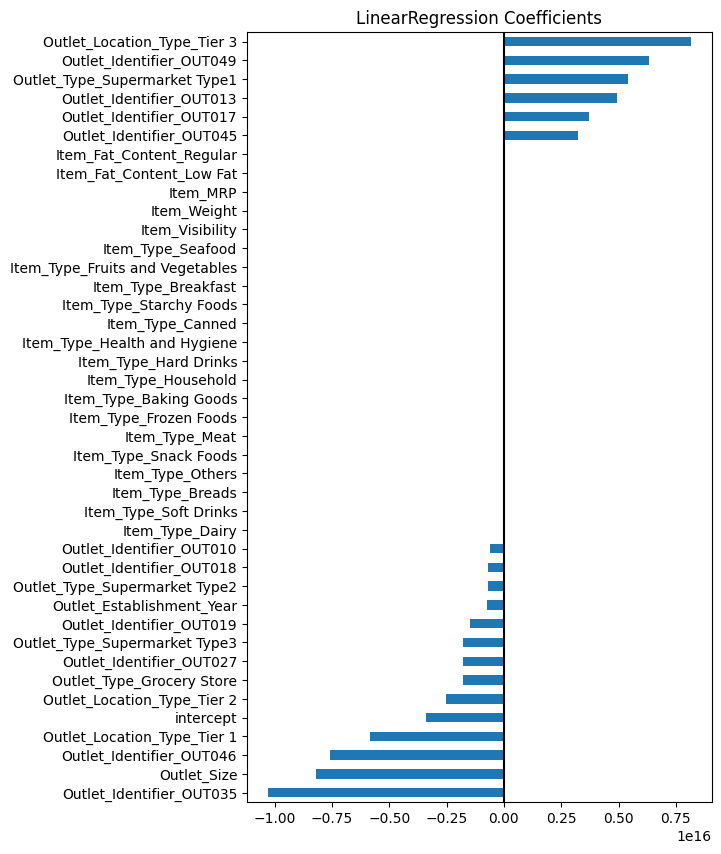

In [111]:
# Plot the coefficients
ax = coeffs.sort_values().plot(kind='barh',figsize=(6,10))
ax.axvline(0,color='k')
ax.set_title('LinearRegression Coefficients');

In [112]:
coeff_rank = coeffs.abs().rank().sort_values(ascending=False)
coeff_rank

Outlet_Identifier_OUT035          41.00
Outlet_Size                       40.00
Outlet_Location_Type_Tier 3       39.00
Outlet_Identifier_OUT046          38.00
Outlet_Identifier_OUT049          37.00
Outlet_Location_Type_Tier 1       36.00
Outlet_Type_Supermarket Type1     35.00
Outlet_Identifier_OUT013          34.00
Outlet_Identifier_OUT017          33.00
intercept                         32.00
Outlet_Identifier_OUT045          31.00
Outlet_Location_Type_Tier 2       30.00
Outlet_Type_Grocery Store         29.00
Outlet_Identifier_OUT027          28.00
Outlet_Type_Supermarket Type3     27.00
Outlet_Identifier_OUT019          26.00
Outlet_Establishment_Year         25.00
Outlet_Type_Supermarket Type2     24.00
Outlet_Identifier_OUT018          23.00
Outlet_Identifier_OUT010          22.00
Item_Type_Dairy                   21.00
Item_Type_Soft Drinks             20.00
Item_Type_Breads                  19.00
Item_Type_Others                  18.00
Item_Type_Snack Foods             17.00


In [113]:
top_n_features = coeff_rank.head(10)
top_n_features

Outlet_Identifier_OUT035        41.00
Outlet_Size                     40.00
Outlet_Location_Type_Tier 3     39.00
Outlet_Identifier_OUT046        38.00
Outlet_Identifier_OUT049        37.00
Outlet_Location_Type_Tier 1     36.00
Outlet_Type_Supermarket Type1   35.00
Outlet_Identifier_OUT013        34.00
Outlet_Identifier_OUT017        33.00
intercept                       32.00
dtype: float64

In [114]:
# Slice out the top_n_features names to visualize
plot_vals = coeffs.loc[top_n_features.index]
plot_vals

Outlet_Identifier_OUT035        -10,282,732,478,653,100.00
Outlet_Size                      -8,203,649,271,234,298.00
Outlet_Location_Type_Tier 3       8,151,862,937,270,039.00
Outlet_Identifier_OUT046         -7,572,603,001,578,697.00
Outlet_Identifier_OUT049          6,317,990,546,919,117.00
Outlet_Location_Type_Tier 1      -5,855,739,326,445,862.00
Outlet_Type_Supermarket Type1     5,399,776,574,584,387.00
Outlet_Identifier_OUT013          4,949,145,561,938,562.00
Outlet_Identifier_OUT017          3,697,277,946,256,142.50
intercept                        -3,399,507,136,996,110.50
dtype: float64

In [115]:
top_n = 10
coeff_rank = coeffs.abs().rank().sort_values(ascending=False)
top_n_features = coeff_rank.head(top_n).index
plot_vals = coeffs.loc[top_n_features].sort_values()
plot_vals

Outlet_Identifier_OUT035        -10,282,732,478,653,100.00
Outlet_Size                      -8,203,649,271,234,298.00
Outlet_Identifier_OUT046         -7,572,603,001,578,697.00
Outlet_Location_Type_Tier 1      -5,855,739,326,445,862.00
intercept                        -3,399,507,136,996,110.50
Outlet_Identifier_OUT017          3,697,277,946,256,142.50
Outlet_Identifier_OUT013          4,949,145,561,938,562.00
Outlet_Type_Supermarket Type1     5,399,776,574,584,387.00
Outlet_Identifier_OUT049          6,317,990,546,919,117.00
Outlet_Location_Type_Tier 3       8,151,862,937,270,039.00
dtype: float64

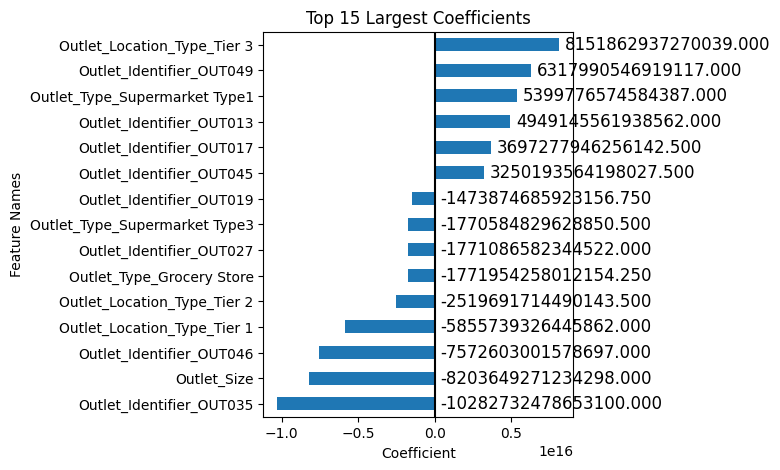

In [116]:
plot_coeffs(coeffs, top_n=15, annotate=True);

In [117]:
evaluate_regression(lin_reg_2, X_train_2, y_train, X_test_2,y_test)

------------------------------------------------------------
Regression Metrics:  Training Data
------------------------------------------------------------
- MAE = 848.194
- MSE = 1,298,814.122
- RMSE = 1,139.655
- R^2 = 0.561

------------------------------------------------------------
Regression Metrics:  Test Data
------------------------------------------------------------
- MAE = 807.189
- MSE = 1,199,635.872
- RMSE = 1,095.279
- R^2 = 0.565


####Conclusions

The top 3 coefficients are Outlet Location Type Tier 2, Outlet Identifier - OUT049, and Outlet Location Type - Tier 3. Sales from these locations positively influence the target (Item Outlet Sales)

###Tree Based Model:

In [118]:
reg_seed = RandomForestRegressor(random_state=SEED)
reg_seed.fit(X_train_2, y_train)
evaluate_regression(reg_seed, X_train_2, y_train, X_test_2, y_test)

------------------------------------------------------------
Regression Metrics:  Training Data
------------------------------------------------------------
- MAE = 297.096
- MSE = 183,069.103
- RMSE = 427.866
- R^2 = 0.938

------------------------------------------------------------
Regression Metrics:  Test Data
------------------------------------------------------------
- MAE = 769.146
- MSE = 1,225,856.567
- RMSE = 1,107.184
- R^2 = 0.556


In [119]:
# Get Feature importances
reg_seed.feature_importances_

array([6.14870729e-03, 5.27194451e-02, 9.83947910e-02, 4.41615282e-01,
       2.85297151e-02, 5.30168880e-03, 5.24464027e-03, 4.21721132e-03,
       2.62170946e-03, 2.82129600e-03, 4.31473501e-03, 6.54660365e-03,
       5.80666413e-03, 7.43544031e-03, 2.98798677e-03, 3.97162516e-03,
       6.25054097e-03, 3.73618739e-03, 1.58472879e-03, 1.82749312e-03,
       8.38450748e-03, 5.68894964e-03, 3.32441929e-03, 1.09943537e-05,
       1.70234482e-03, 3.96793412e-03, 1.14164160e-03, 1.39068894e-05,
       2.99936044e-02, 4.30927862e-03, 4.61205447e-03, 3.73343315e-03,
       4.41185390e-03, 3.33280353e-03, 3.02977035e-03, 2.94886526e-03,
       1.91709016e-01, 1.67515853e-03, 1.34162596e-03, 3.25913466e-02])

In [120]:
# Save the feature importances
tree_importances = pd.Series(reg_seed.feature_importances_, index = feature_names, name = 'Feature Importance')
tree_importances

Outlet_Size                       0.01
Item_Weight                       0.05
Item_Visibility                   0.10
Item_MRP                          0.44
Outlet_Establishment_Year         0.03
Item_Fat_Content_Low Fat          0.01
Item_Fat_Content_Regular          0.01
Item_Type_Baking Goods            0.00
Item_Type_Breads                  0.00
Item_Type_Breakfast               0.00
Item_Type_Canned                  0.00
Item_Type_Dairy                   0.01
Item_Type_Frozen Foods            0.01
Item_Type_Fruits and Vegetables   0.01
Item_Type_Hard Drinks             0.00
Item_Type_Health and Hygiene      0.00
Item_Type_Household               0.01
Item_Type_Meat                    0.00
Item_Type_Others                  0.00
Item_Type_Seafood                 0.00
Item_Type_Snack Foods             0.01
Item_Type_Soft Drinks             0.01
Item_Type_Starchy Foods           0.00
Outlet_Identifier_OUT010          0.00
Outlet_Identifier_OUT013          0.00
Outlet_Identifier_OUT017 

In [121]:
# Saving the feature importances sorted from smallest to largest (ascending=True)
sorted_trees = tree_importances.sort_values()
sorted_trees

Outlet_Identifier_OUT010          0.00
Outlet_Identifier_OUT019          0.00
Outlet_Identifier_OUT018          0.00
Outlet_Type_Supermarket Type2     0.00
Item_Type_Others                  0.00
Outlet_Type_Supermarket Type1     0.00
Outlet_Identifier_OUT013          0.00
Item_Type_Seafood                 0.00
Item_Type_Breads                  0.00
Item_Type_Breakfast               0.00
Outlet_Location_Type_Tier 3       0.00
Item_Type_Hard Drinks             0.00
Outlet_Location_Type_Tier 2       0.00
Item_Type_Starchy Foods           0.00
Outlet_Location_Type_Tier 1       0.00
Outlet_Identifier_OUT046          0.00
Item_Type_Meat                    0.00
Outlet_Identifier_OUT017          0.00
Item_Type_Health and Hygiene      0.00
Item_Type_Baking Goods            0.00
Outlet_Identifier_OUT035          0.00
Item_Type_Canned                  0.00
Outlet_Identifier_OUT049          0.00
Outlet_Identifier_OUT045          0.00
Item_Fat_Content_Regular          0.01
Item_Fat_Content_Low Fat 

####Visualizing Feature Coefficients

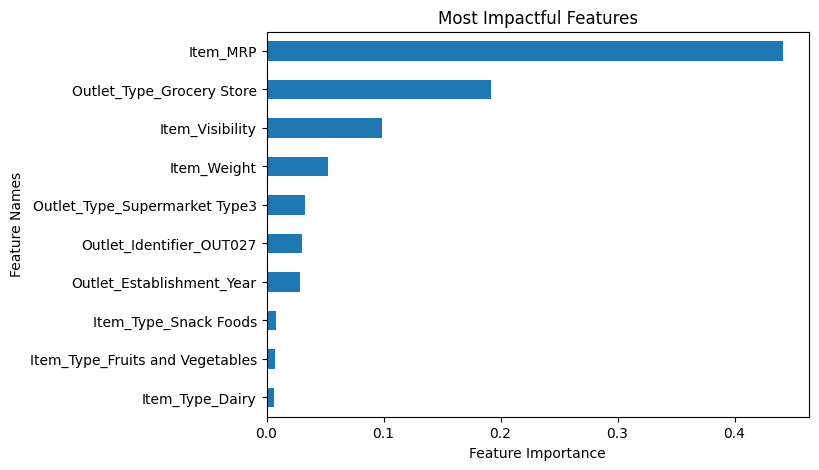

In [123]:
# Visualization of importances
ax = sorted_trees.tail(10).plot(kind='barh', figsize=(7,5),)
ax.set(xlabel='Feature Importance',
        ylabel='Feature Names',
        title='Most Impactful Features');

In [126]:
importances = get_importances(reg_seed,sort=True,ascending=False)
importances

Item_MRP                          0.44
Outlet_Type_Grocery Store         0.19
Item_Visibility                   0.10
Item_Weight                       0.05
Outlet_Type_Supermarket Type3     0.03
Outlet_Identifier_OUT027          0.03
Outlet_Establishment_Year         0.03
Item_Type_Snack Foods             0.01
Item_Type_Fruits and Vegetables   0.01
Item_Type_Dairy                   0.01
Item_Type_Household               0.01
Outlet_Size                       0.01
Item_Type_Frozen Foods            0.01
Item_Type_Soft Drinks             0.01
Item_Fat_Content_Low Fat          0.01
Item_Fat_Content_Regular          0.01
Outlet_Identifier_OUT045          0.00
Outlet_Identifier_OUT049          0.00
Item_Type_Canned                  0.00
Outlet_Identifier_OUT035          0.00
Item_Type_Baking Goods            0.00
Item_Type_Health and Hygiene      0.00
Outlet_Identifier_OUT017          0.00
Item_Type_Meat                    0.00
Outlet_Identifier_OUT046          0.00
Outlet_Location_Type_Tier

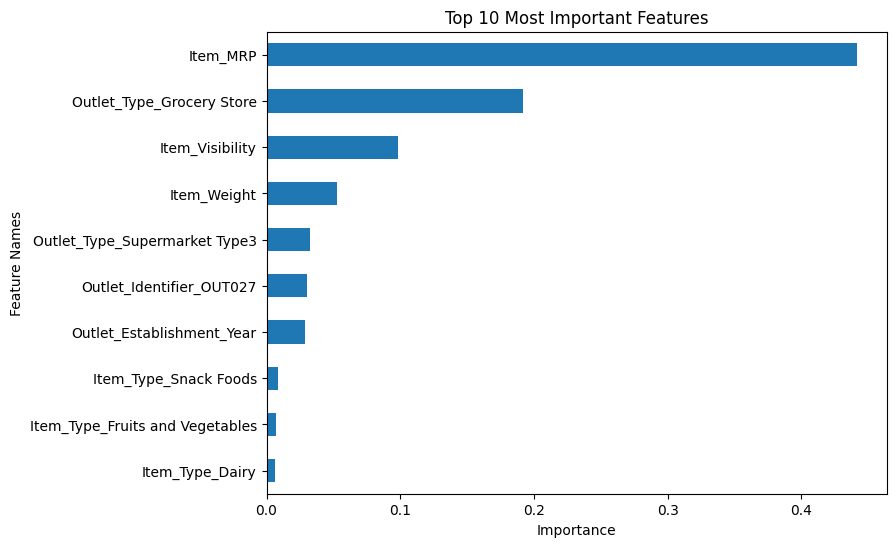

In [127]:
importances = get_importances(reg_seed,sort=True,ascending=False,
                              name="RandomForest Importances")
plot_importance(importances,top_n=10);

In [128]:
importances.sort_values(ascending=False).head(5)

Item_MRP                        0.44
Outlet_Type_Grocery Store       0.19
Item_Visibility                 0.10
Item_Weight                     0.05
Outlet_Type_Supermarket Type3   0.03
Name: RandomForest Importances, dtype: float64

In [129]:
plot_train = pd.concat([X_train_2,y_train],axis=1)
plot_test = pd.concat([X_test_2,y_test],axis=1)
plot_df = pd.concat([plot_train, plot_test])
plot_df

,Outlet_Size,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year,Item_Fat_Content_Low Fat,Item_Fat_Content_Regular,Item_Type_Baking Goods,Item_Type_Breads,Item_Type_Breakfast,Item_Type_Canned,Item_Type_Dairy,Item_Type_Frozen Foods,Item_Type_Fruits and Vegetables,Item_Type_Hard Drinks,Item_Type_Health and Hygiene,Item_Type_Household,Item_Type_Meat,Item_Type_Others,Item_Type_Seafood,Item_Type_Snack Foods,Item_Type_Soft Drinks,Item_Type_Starchy Foods,Outlet_Identifier_OUT010,Outlet_Identifier_OUT013,Outlet_Identifier_OUT017,Outlet_Identifier_OUT018,Outlet_Identifier_OUT019,Outlet_Identifier_OUT027,Outlet_Identifier_OUT035,Outlet_Identifier_OUT045,Outlet_Identifier_OUT046,Outlet_Identifier_OUT049,Outlet_Location_Type_Tier 1,Outlet_Location_Type_Tier 2,Outlet_Location_Type_Tier 3,Outlet_Type_Grocery Store,Outlet_Type_Supermarket Type1,Outlet_Type_Supermarket Type2,Outlet_Type_Supermarket Type3,Item_Outlet_Sales
4776,0.29,0.82,-0.71,1.83,1.33,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,515.33
7510,0.29,0.56,-1.29,0.60,1.33,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,"3,056.02"
5828,0.29,-0.13,1.81,0.24,0.14,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,"1,577.95"
5327,-1.38,-1.17,-1.00,-0.95,0.73,1.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,"1,331.60"
4810,0.29,1.53,-0.97,-0.34,0.49,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,"1,687.14"
4377,-1.38,0.00,-0.11,-0.51,-1.53,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,111.85
2280,-1.38,1.88,-0.07,-0.86,0.73,0.00,1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,"1,151.17"
8198,0.29,0.00,-0.05,1.94,-1.53,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,"3,401.57"
7514,-1.38,1.61,1.85,1.80,0.73,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,"3,570.02"
3463,-1.38,-1.12,-0.53,-0.42,0.73,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,"1,523.35"


In [130]:
drop_cols = ['Outlet_Establishment_Year']
X_train_B = X_train_processed.drop(columns = drop_cols)
X_test_B = X_test_processed.drop(columns= drop_cols)
feature_names_B = X_train_B.columns
X_train_B.head(3)

,Outlet_Size,Item_Weight,Item_Visibility,Item_MRP,Item_Fat_Content_Low Fat,Item_Fat_Content_Regular,Item_Type_Baking Goods,Item_Type_Breads,Item_Type_Breakfast,Item_Type_Canned,Item_Type_Dairy,Item_Type_Frozen Foods,Item_Type_Fruits and Vegetables,Item_Type_Hard Drinks,Item_Type_Health and Hygiene,Item_Type_Household,Item_Type_Meat,Item_Type_Others,Item_Type_Seafood,Item_Type_Snack Foods,Item_Type_Soft Drinks,Item_Type_Starchy Foods,Outlet_Identifier_OUT010,Outlet_Identifier_OUT013,Outlet_Identifier_OUT017,Outlet_Identifier_OUT018,Outlet_Identifier_OUT019,Outlet_Identifier_OUT027,Outlet_Identifier_OUT035,Outlet_Identifier_OUT045,Outlet_Identifier_OUT046,Outlet_Identifier_OUT049,Outlet_Location_Type_Tier 1,Outlet_Location_Type_Tier 2,Outlet_Location_Type_Tier 3,Outlet_Type_Grocery Store,Outlet_Type_Supermarket Type1,Outlet_Type_Supermarket Type2,Outlet_Type_Supermarket Type3
4776,0.29,0.82,-0.71,1.83,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00
7510,0.29,0.56,-1.29,0.60,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,1.00,0.00
5828,0.29,-0.13,1.81,0.24,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00


####Conclusion

From our two models we inspected, we can see the most impactful features for these models were:

1) Item MRP

2) Outlet Type - Grocery Store

3) Item Visibility

4) Item Weight

5) Outlet Type - Supermarket